In [1]:
# ;export CUDA_VISIBLE_DEVICES=2

In [3]:
using CUDA, Flux
import JLD2
using Base.Threads
CUDA.device_reset!()
CUDA.device!(1)
Threads.nthreads()

16

In [4]:
# E0i
include("../therm.jl")

In [5]:
PATH = "/home/javier/Projects/RBM/Results/"
# l=100
# nv=28*28
# nh=784 #500
dev = gpu
β = 1.0
# modelName = "CD-500-T1000-5-BW-replica1-L"
modelName = "PCD-500-replica1"
rbm, J, m, hparams, opt = loadModel(modelName, gpu);
x_i, y_i = loadData(; hparams, dsName="MNIST01", numbers=collect(0:9), testset=true);

[ Info: /home/javier/Projects/RBM/Results/models/PCD-500-replica1
[ Info: Loadding model J_100.
[ Info: 10000


In [6]:
idx=100
J = load("$(PATH)/models/$(modelName)/J/J_$(idx).jld", "J")
J.w = gpu(J.w)
J.b = gpu(J.b)
J.a = gpu(J.a)
F = LinearAlgebra.svd(J.w, full=true);

In [7]:
v_val,h_val, x_val,y_val = data_val_samples(F, avg=true)
# v,h = gibbs_sampling(v,h,J)
# umean, wmean, σ_2u, σ_2w, a0, b0, λ = compute_stats(v, h, J);

(Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], Float32[2.0484727f-7 0.39014405 … 0.00021456323 1.4218863f-6; 0.00076075434 0.022999823 … 0.7812286 0.16163157; … ; 0.90754884 0.6699251 … 0.86097664 0.86449045; 0.9610517 0.00016031957 … 0.93326366 0.9611992], Float32[-3.5242922 -3.541488 … -2.4542787 -2.8604329; -0.52427995 -1.0518093 … -2.4614015 -1.6099365; … ; 0.042491894 -0.037596025 … -0.02380246 0.1315117; -0.035178944 -0.02327267 … 0.076679856 -0.02516035], Float32[3.8722882 4.1628428 … 4.9084344 4.371888; 0.8255613 0.31221682 … -1.5700493 -0.5422807; … ; 0.1018461 0.013582408 … -0.0127111375 0.022906065; 0.010246336 -0.015163511 … -0.044042856 -0.18074396])

In [23]:
size(y_val)

(500, 10000)

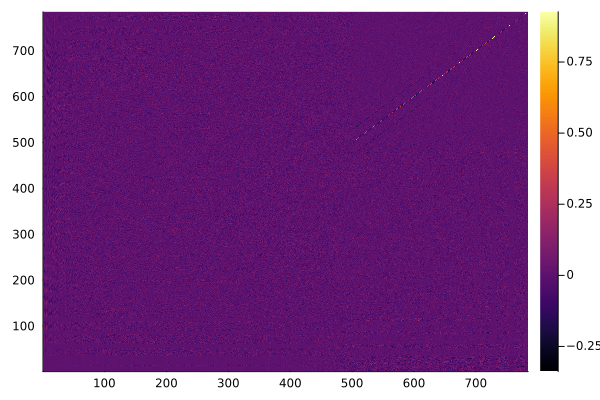

In [24]:
heatmap(cpu(F.U))

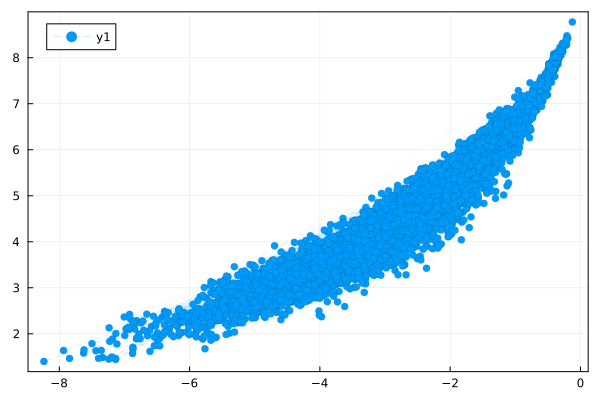

In [8]:
plot(x_val[1,:], y_val[1,:], s=:auto, markershapes = :circle, lw=0.0, markerstrokewidth=0.1, frame=:box)

In [7]:
v = sign.(rand(hparams.nv, 500) .< 0.5) |> dev ;
h = sign.(rand(hparams.nh, 500) .< 0.5) |> dev ;
# v,h = gibbs_sampling(rbm.v,rbm.h,J; mcs=500)
v,h = gibbs_sampling(v,h,J; mcs=500)

(Float32[0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0; … ; 0.0 0.0 … 0.0 0.0; 0.0 0.0 … 0.0 0.0], Float32[0.0 1.0 … 0.0 0.0; 1.0 1.0 … 0.0 1.0; … ; 1.0 1.0 … 1.0 1.0; 1.0 0.0 … 0.0 1.0])

In [339]:
# v_samp = Array(rbm.v);

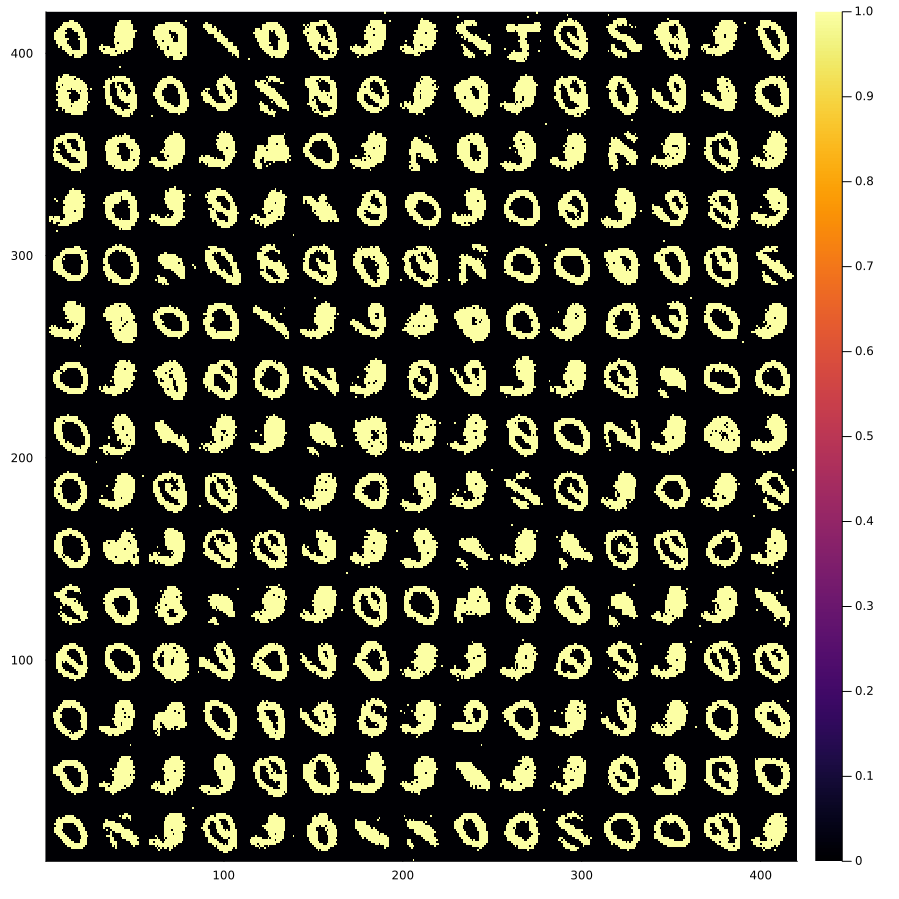

In [8]:
lnum=15
heatmap(cat([cat([reshape(v[:,i+j*lnum],28,28) for i in 1:lnum]..., dims=2) for j in 0:lnum-1]...,dims=1), size=(900,900))

In [126]:
z = cat(x_val[1:500,:], y_val, dims=1);

In [97]:
Cov = cov(z');
C = cholesky(Hermitian(Cov));

In [11]:
nsamples = 10000
z_samples = reshape(mean(z,dims=2),:) .+ C.L * randn(size(z,1),nsamples);
x_samples = z_samples[1:500,:]
y_samples = z_samples[501:1000,:];

In [3]:
plot(x_val[1,:], y_val[1,:], s=:auto, markershapes = :circle, lw=0.0, markerstrokewidth=0.1, frame=:box)
plot!(x_samples[1,:], y_samples[1,:], s=:auto, markershapes = :circle, lw=0.0, markerstrokewidth=0.1, frame=:box, xlabel="x", ylabel="y")


In [8]:
Δz = z .- reshape(mean(z, dims=2),:);

In [9]:
function get_corr_function(Δz, sz, sh)
    sz_ar = sz * ones(Int, sh)
    corr = Array{Float32}(undef,sz_ar...)
    if sh == 2
        @threads for i in 1:sz
            @threads for j in 1:sz
                corr[i,j] = get_corr_idx(Δz, [i,j])
            end
        end
        # corr = [get_corr_idx(Δz, [i,j]) for i in 1:sz, j in 1:sz]
    elseif sh == 3
        @threads for i in 1:sz
            @threads for j in 1:sz
                for k in 1:sz
                    corr[i,j,k] = get_corr_idx(Δz, [i,j,k])
                end
            end
        end
        # corr = [get_corr_idx(Δz, [i,j,k]) for i in 1:sz, j in 1:sz, k in 1:sz]
    elseif sh == 4
        @threads for i in 1:sz
            @threads for j in 1:sz
                for k in 1:sz
                    for l in 1:sz
                        corr[i,j,k,l] = get_corr_idx(Δz, [i,j,k,l])
                    end
                end
            end
        end
        # corr = [get_corr_idx(Δz, [i,j,k,l]) for i in 1:sz, j in 1:sz, k in 1:sz, l in 1:sz]
    end
    return corr
end
    
function get_corr_idx(Δz, idx)
    # Δz_gpu = gpu(Δz)
    # return mean(prod(hcat([Δz_gpu[i,:] for i in idx]...), dims=2))
    return mean(prod(gpu(Δz[idx,:]), dims=1))
end

get_corr_idx (generic function with 1 method)

In [11]:
# cov3points = get_corr_function(Δz[:,1:1000], 50, 3)
# cov4points = get_corr_function(Δz[:,1:1000], 10, 4)

In [22]:
# ∇lnpz
a0 = F.U' * J.a
b0 = F.Vt * J.b
c = cpu(cat(a0[1:500],b0, dims=1));

bigLambda = zeros(1000,1000);
bigLambda[501:end,1:500] = Diagonal(F.S/sum(F.S))
# bigLambda[501:end,1:500] = Diagonal(F.S)
bigLambda[1:500,501:1000] = Diagonal(F.S/sum(F.S))
# bigLambda[1:500,501:1000] = Diagonal(F.S)

∇lnpz(z) = c + bigLambda * z - 0.5 * Cov * z
∇lnpz(z) = c .+ bigLambda * z - 0.5 .* Cov * z
∇lnpz_gpu(z) = gpu(c) .+ gpu(bigLambda) * gpu(z) - 0.5 .* gpu(Cov) * gpu(z)

∇lnpz0(z) = c - 0.5 .* Cov * z
∇lnpz0_gpu(z_p) = - gpu(Hermitian(Cov)) * (z_p .- gpu(reshape(mean(z,dims=2),:)))    # reshape(mean(z,dims=2),:)

∇lnpz0_gpu (generic function with 1 method)

In [14]:
# z_prop = z_samples;

In [23]:
# η = 0.5
dt = 0.0001
D = 1.0
z_prop = z_samples[:,1:500] |> gpu;
for i in 1:10000
    z_prop = z_prop + dt .* ∇lnpz0_gpu(z_prop) + √(2*D*dt) .* gpu(C.L * randn(size(z_prop)))
end

In [4]:
# z_prop
x_prop = z_prop[1:500,:]
y_prop = z_prop[501:1000,:];
indx = 1
samps = 500

plot(x_val[indx,1:samps], y_val[indx,1:samps], s=:auto, markershapes = :circle, lw=0.0, markerstrokewidth=0.1, frame=:box, label="MNIST data")
plot!(x_samples[indx,1:samps], y_samples[indx,1:samps], s=:auto, markershapes = :circle, lw=0.0, markerstrokewidth=0.1, frame=:box, xlabel="x", ylabel="y",label="initial state")
plot!(x_prop[indx,:], y_prop[indx,:], s=:auto, markershapes = :circle, lw=0.0, markerstrokewidth=0.1, frame=:box, xlabel="x", ylabel="y", label="final state")


In [180]:
# heatmap(bigLambda)

In [212]:
# heatmap(Cov)

In [182]:
# plot(reshape(sum(Cov - bigLambda,dims=1),:))
# plot!(reshape(sum(Cov,dims=1),:))

In [183]:
# plot(reshape(sum(Cov - bigLambda,dims=2),:))
# plot!(reshape(sum(Cov,dims=2),:))

In [194]:
l,d = eigen(Hermitian(Cov));

In [300]:
########################

In [26]:
function exp_arg(x_val,y_val, F, hparams)
    λ = cpu(F.S)
    
    nh = min(size(y_val,1), size(x_val,1))
    nv = max(size(y_val,1), size(x_val,1))

    z = size(y_val,1) <= size(x_val,1) ? cat(y_val, x_val, dims=1) : cat(x_val, y_val, dims=1)

    μ = reshape(mean(z, dims=2), :)
    C = cov(z[1:2*nh,:]')
    Cinv = inv(C)
    # @assert C * Cinv ≈ I

    mat_size = 2*nh
    G = zeros(mat_size,mat_size)
    for j in mat_size-nh+1:mat_size
        i = j-nh
        G[i,j] = ( i <= nh ? λ[i] : 0 ) # 1.0
    end
    G = G + transpose(G)
    G = (Cinv+Cinv')/2 + G;
    # G = Cinv + G;
    
    a0 = F.U' * J.a
    b0 = F.Vt * J.b
    c = size(b0,1) <= size(a0,1) ? cpu(cat(b0,a0, dims=1)) : cpu(cat(a0,b0, dims=1))

    ϵ2 = zeros(mat_size)
    ϵ2[1:nh] = [μ[nh + i]*λ[i] for i in 1:nh ]
    ϵ2[end-nh+1:end] = [μ[i]*λ[i] for i in 1:nh ]

    if nv > nh
        ϵ = c + cat(ϵ2, zeros(nv - nh), dims=1);
        B = inv(cov(z[2*nh+1:end,:]'));
    else
        ϵ = c + ϵ2;
        B = 0;
    end
    return z, λ, μ, ϵ, G, B, c, C
end

function eff_log_partition_function(λ, μ, ϵ, G, B, hparams)
    nh = Int(size(G,1)/2)
    nv = typeof(B) != Int64 ? size(B,1) + nh : nh
    if typeof(B) != Int64
        return 0.5 * (ϵ[1:2*nh]' * inv(G) * ϵ[1:2*nh] + ϵ[2*nh+1:end]' * inv(B) * ϵ[2*nh+1:end]) + μ' * ϵ + nv/2 * log(2π) - sum([μ[i] * μ[i+ nh] * λ[i] for i in 1:nh]) - 0.5 * (sum(log.(eigen(G).values[eigen(G).values .> 0])) + sum(log.(eigen(B).values)))
    else
        return 0.5 * (ϵ[1:2*nh]' * inv(G) * ϵ[1:2*nh]) + μ' * ϵ + nv/2 * log(2π) - sum([μ[i] * μ[i+ nh] * λ[i] for i in 1:nh]) - 0.5 * (sum(log.(eigen(G).values[eigen(G).values .> 0])) )
    end
end

eff_log_partition_function (generic function with 1 method)

In [27]:
z, λ, μ, ϵ, G, B, γ, C = exp_arg(x_val,y_val, F, hparams)
# z, λ, μ, ϵ, G, B, γ, C = exp_arg(y_val,x_val, F, hparams)
eff_log_partition_function(λ, μ, ϵ, G, B, hparams)

-3253.4712896482115

In [303]:
# d,v = eigen((C+C')/2)
# idx = min(size(d,1), 1)
# C0 = sum([d[i] * v[:,i] * v[:,i]' for i in size(d,1):-1:size(d,1) - idx + 1])
# G0 = (inv(C0)+inv(C0)')/2 + G
# eigen(G).values

In [221]:
# # idx=1
# logZ = []
# for idx in 1:1:100
#     J = load("$(PATH)/models/$(modelName)/J/J_$(idx).jld", "J")
#     J.w = gpu(J.w)
#     J.b = gpu(J.b)
#     J.a = gpu(J.a)
#     F = LinearAlgebra.svd(J.w, full=true);
#     v_val,h_val, x_val,y_val = data_val_samples(F)
#     z, λ, μ, ϵ, G, B = exp_arg(x_val,y_val, F, hparams)
#     push!(logZ, eff_log_partition_function(λ, μ, ϵ, G, B, hparams))
# end
using StatsPlots


In [28]:
# plot(z[1,:], z[501,:])
z_rot = eigen(G).vectors * z[1:2*hparams.nh,:]
μ_rot = eigen(G).vectors * μ[1:2*hparams.nh];
# Δz_rot = z_rot .- μ_rot;

z_rot_2 = eigen(B).vectors * z[2*hparams.nh+1:end,:];
μ_rot_2 = eigen(B).vectors * μ[2*hparams.nh+1:end];

In [29]:
# plot(z_rot[1,:], z_rot[501,:])

# corrplot(Δz_rot[[1,2,3,501,502,503],:]', label = ["$i" for i in [1,2,3,501,502,503]], compact=true, size=(700,700))

In [30]:
Cov_z1 = cov(z_rot');
Ch_z1 = cholesky(Hermitian(Cov_z1));

Cov_z2 = cov(z_rot_2');
Ch_z2 = cholesky(Hermitian(Cov_z2));

In [31]:
nsamples = 10000
z_samples = μ_rot .+ Ch_z1.L * randn(2*hparams.nh,nsamples); #reshape(mean(z,dims=2),:)
y_samples = z_samples[1:500,:]
x_samples = z_samples[501:1000,:];


z_samples_2 = μ_rot_2 .+ Ch_z2.L * randn(hparams.nv - hparams.nh,nsamples); 
x_samples_2 = z_samples_2;

In [35]:
size(z_rot)

(1000, 10000)

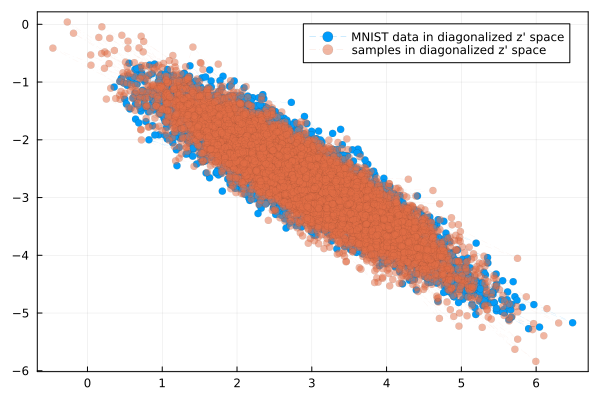

In [49]:
i=1
# plot(z[i,:], z[500+i,:], s=:auto, markershapes = :circle, lw=0.0, markerstrokewidth=0.1, frame=:box, label="MNIST data")
plot(z_rot[i,:], z_rot[500+i,:], s=:auto, markershapes = :circle, lw=0.0, markerstrokewidth=0.1, frame=:box, label="MNIST data in diagonalized z' space")
plot!(y_samples[i,1:10000], x_samples[i,1:10000], s=:auto, markershapes = :circle, lw=0.0, markerstrokewidth=0.1, frame=:box, label="samples in diagonalized z' space", opacity=0.5)

In [38]:
z_samples_unrot = eigen(G).vectors' * z_samples
y_samples_unrot = z_samples_unrot[1:500,:]
x_samples_unrot = z_samples_unrot[501:1000,:];

z_samples_unrot_2 = eigen(B).vectors' * z_samples_2
x_samples_unrot_2 = z_samples_unrot_2;

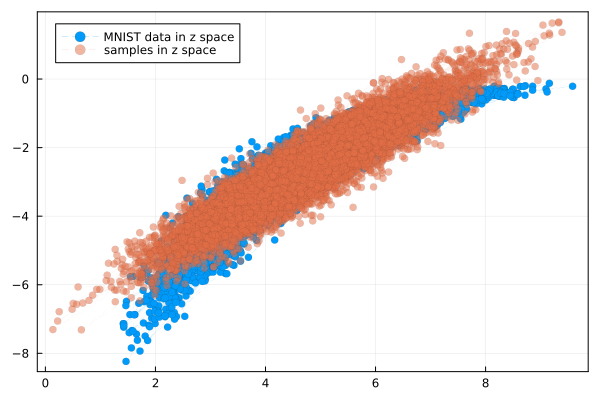

In [50]:
i=1
plot(z[i,:], z[500+i,:], s=:auto, markershapes = :circle, lw=0.0, markerstrokewidth=0.1, frame=:box, label="MNIST data in z space")
plot!(y_samples_unrot[i,1:10000], x_samples_unrot[i,1:10000], s=:auto, markershapes = :circle, lw=0.0, markerstrokewidth=0.1, frame=:box, label="samples in z space", opacity=0.5)
# plot!(z_prop[i,:], z_prop[500+i,:], s=:auto, markershapes = :circle, lw=0.0, markerstrokewidth=0.1, frame=:box, label="MNIST data")

In [51]:
# v_samples_fc = cpu(F.U) * vcat(x_samples_unrot, x_val[501:end,:]);
# v_samples_fc = cpu(F.U) * x_val
# v_samples_fc = cpu(F.U) * vcat(x_samples_unrot, x_samples_unrot_2);

v_samples_fc = σ.(cpu(F.U) * vcat(cpu(Diagonal(F.S)), zeros(hparams.nv - hparams.nh, hparams.nh) ) * z[1:500,:] .+ cpu(J.a));

# v_samples_fc = σ.(cpu(F.U) * vcat(cpu(Diagonal(F.S)), zeros(hparams.nv - hparams.nh, hparams.nh) ) * y_samples_unrot .+ cpu(J.a));
v_samples_fc = Array{Float32}(sign.(rand(hparams.nv, 10000) .< v_samples_fc));

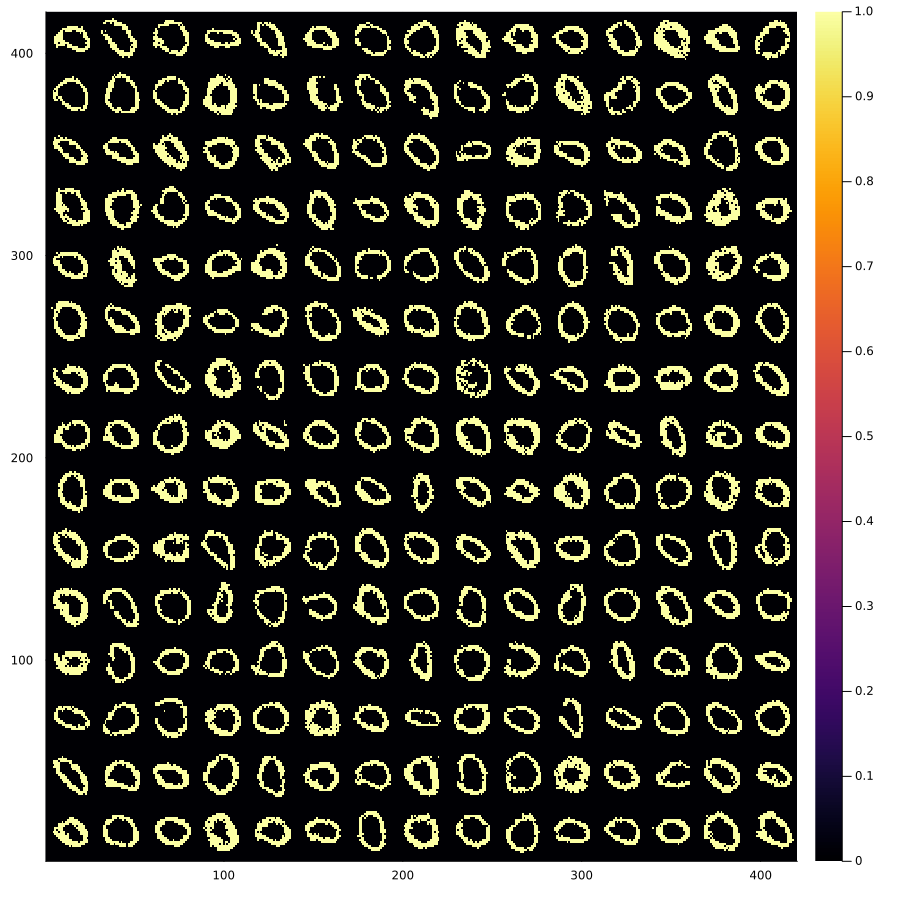

In [52]:
# vcat(x_samples_unrot, x_val[501:end,:])
# heatmap(reshape(v_samples_fc[:,310],28,28))
lnum=15
heatmap(cat([cat([reshape(v_samples_fc[:,i+j*lnum],28,28) for i in 1:lnum]..., dims=2) for j in 0:lnum-1]...,dims=1), size=(900,900))

In [329]:
# heatmap(cat([cat([reshape(v_samples_fc[:,i+j*lnum],28,28) for i in 1:lnum]..., dims=2) for j in 0:lnum-1]...,dims=1), size=(900,900))

In [107]:
# γ[1:2*hparams.nh]
force(z_prop, λ) = vcat(z_prop[1+hparams.nh:2*hparams.nh,:] .* λ, z_prop[1:hparams.nh,:] .* λ)

force (generic function with 2 methods)

In [112]:
dt = 0.00001
D = 1.0
C = cov(z[1:2*hparams.nh,:]')
Chol = cholesky(Hermitian(C));

z_prop = z_samples_unrot[:,1:500] |> gpu;

for i in 1:100
    z_prop = z_prop + dt .* force(z_prop, gpu(λ)) + √(2*D*dt) .* gpu(Chol.L * randn(size(z_prop)))
    # z_prop = z_prop + √(2*D*dt) .* gpu(Chol.L * randn(size(z_prop)))
end
z_prop = z_prop |> cpu;

In [12]:
#### Corr breaking point

In [54]:
cov_break_point = []
for i in 2:hparams.nh+hparams.nv
    C = cov(z[1:i,:]')
    # sum(C * inv(C))
    # push!(cov_break_point, det(C))
    push!(cov_break_point, sum(C * inv(C))/i)
end

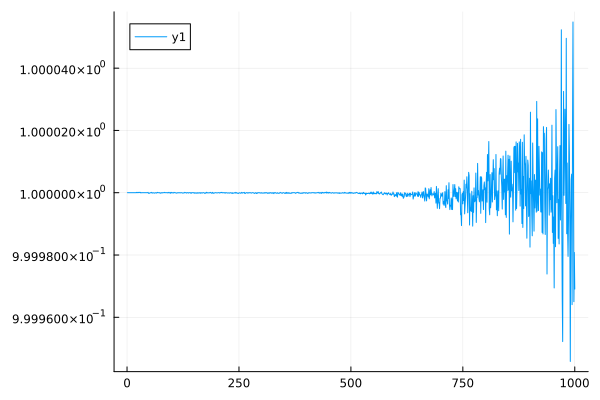

In [33]:
plot(abs.(cov_break_point[1:1000]))

In [35]:

@assert sum(C * inv(C)) ≈ 2*hparams.nh

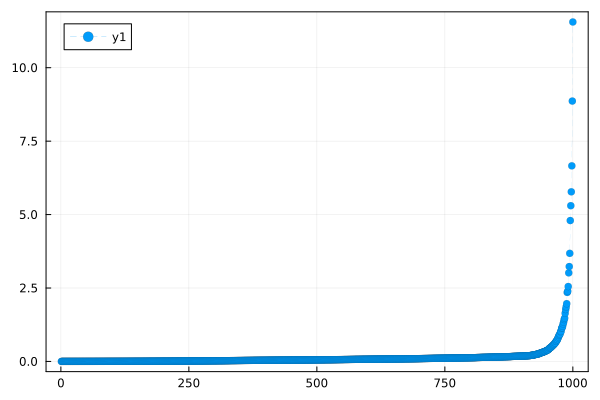

In [39]:
d,v = eigen(C)
plot(d, s=:auto, markershapes = :circle, lw=0.0, markerstrokewidth=0.1, frame=:box)

In [51]:
# ?eigen
det(sum([d[i] .* v[:,i] * v[:,i]' for i in size(d,1):-1:size(d,1)-1]))

0.0f0

In [71]:
z_samples_unrot

1000×10000 Matrix{Float64}:
  6.35147      4.92785     4.96782     …   4.96894      7.1053      5.47305
  0.526452     1.97047     0.820672        0.460507     0.657943    0.971689
  0.765064    -2.2598     -2.17699        -0.997982     0.426702    0.757342
 -0.530342    -3.13859     0.482142        0.811602     0.933043    0.863777
 -1.26468     -0.706642   -0.714162        0.620572    -1.27738     0.437134
  0.590541     1.07801     0.264416    …   1.2727      -0.316533    0.208251
  0.738985     0.220032   -0.433668       -0.529029     0.193778   -1.85836
  1.90403     -1.28908    -0.999279        1.48356      0.903351    0.818574
 -0.0456778   -0.559593    0.239025       -0.780389     0.8448     -0.981234
 -0.198713     0.748877    0.716315       -1.2565       1.66951     0.277082
  0.084436     0.380948    1.19399     …  -0.0448785    0.820645   -0.543254
  1.39657      1.23224     1.0127          1.2125      -0.0550903   0.736793
 -0.138013     0.980511    1.04885        -1.51985

In [69]:
z[1:2*hparams.nh,:]

1000×10000 Matrix{Float32}:
  3.87316     4.15023      4.94605     …   5.02259       4.35794
  0.849437    0.455467     0.655995       -1.47576      -0.524357
 -0.897976   -0.955269     0.0792971      -1.0004       -0.674431
 -0.129985    1.14684      1.56831         1.61426       0.338654
 -0.451514   -0.00603027  -1.89966        -1.18079      -1.92575
  0.640707   -0.393821     1.20758     …  -0.54938      -0.733654
  0.912391    1.2154      -0.103635        0.480597      0.413323
  0.1779      4.39015      1.63378         0.455295     -0.0610677
 -0.414886   -0.942473    -1.1162          0.962393     -0.676526
 -1.05973    -1.05662     -0.510152        0.593301      0.18738
  0.064478    1.40732      0.573906    …   1.0944        0.321688
  0.137105    1.3995       1.03278        -0.145322      0.620604
 -0.589742   -1.62076     -1.11159         0.0912497     0.980046
  ⋮                                    ⋱                
  0.0322582   0.160574    -0.171306       -0.16804      -0.